23/07/2024

- Compared to the initial notebook, the parametric form here was changed from 'sigmoid-paramtric' to 'sigmoid'

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import json
import re
import copy

%cd ..
from utils import *

%load_ext autoreload 
%autoreload 2
%config InlineBackend.figure_format = 'retina'

/scratch2/jsalle/ObsScaling


In [2]:
base_llm_benchmark_eval = load_base_llm_benchmark_eval()
eval_result_path = "./eval_results/base_llm_post_training_eval.csv"
post_training_eval = pd.read_csv(eval_result_path)

# Merge 
base_llm_eval_with_post_training = pd.merge(base_llm_benchmark_eval, post_training_eval, on="Model")

SCALING_SETUP_KWARGS = {
    # Data preprocessing: PCA imputation and extraction
    **NONGSM_PCA_PREPROCESS_KWARGS,  # exclude GSM to avoid making the task trivial, e.g., using GSM to predict GSM
    
    # Non-lineariy: sigmoid with parametrized scale and shift
    "nonlinearity": "sigmoid", 

    # Cutoff: 8.4E22 FLOPs corresponding to LLama-2 7B
    "split_method": "cutoff_by_FLOPs (1E21)",
    "cutoff_threshold": 84,

    # Model families: include all we have evaled
    "df_filter": lambda x: x['Model Family'].isin(EVAL_BASE_MODEL_FAMILIES),   
    "df_groupby": 'Model Family',  # group markers by model family

    # Regression: ordinary least squares
    "reg_method": "robust",  
    "reg_kwargs": {"delta": 1.0},  # huber loss with delta=1.0 for normalized target within [0, 1] reduces to OLS
}

################ /!\ NO PCA /!\ ################
SCALING_SETUP_KWARGS['apply_pca'] = False

if 'GSM8K' in ALL_BENCHMARK_METRIC_LIST:
    ALL_BENCHMARK_METRIC_LIST.remove('GSM8K')

PLOT_X_METRICS_LIST = [MODEL_SIZE_METRIC, TRAINING_FLOPS_METRIC, ALL_BENCHMARK_METRIC_LIST]   # plot scaling comparison w.r.t. model size, training FLOPs, and 3 PCs

In [3]:
## GSM8K eval metrics with CoT and self-consistency
GSM8K_METHOD_SCALING_COT_METRIC_MAP = {
    'gsm8k_5_exact_match,flexible-extract': "Naive + Greedy",
    'gsm8k_cot_8_exact_match,flexible-extract': "CoT + Greedy",
}

GSM8K_METHOD_SCALING_SELFCONS_METRIC_MAP = {
    'gsm8k_cot_self_consistency_8_exact_match,score-first-flexible-extract': "CoT + 1 Sample",
    'gsm8k_cot_self_consistency_8_exact_match,maj@5-flexible-extract': "CoT + SC + 5 Samples",
}

GSM8K_METHOD_SCALING_ORIG_METRIC_MAP = {
    **GSM8K_METHOD_SCALING_COT_METRIC_MAP,
    **GSM8K_METHOD_SCALING_SELFCONS_METRIC_MAP,
    'difference': 'CoT - Naive'
}

GSM8K_COT_SCALING_METRICS = list(GSM8K_METHOD_SCALING_COT_METRIC_MAP.keys())
GSM8K_SELFCONS_SCALING_METRICS = list(GSM8K_METHOD_SCALING_SELFCONS_METRIC_MAP.keys())

GSM8K_METHOD_SCALING_METRICS = [
    'gsm8k_5_exact_match,flexible-extract',
    'gsm8k_cot_8_exact_match,flexible-extract',
    # 'gsm8k_cot_self_consistency_8_exact_match,score-first-flexible-extract',
    'gsm8k_cot_self_consistency_8_exact_match,maj@5-flexible-extract',
]

color_palette = sns.color_palette()

GSM8K_METHOD_SCALING_COLOR_MAP = {
    'gsm8k_5_exact_match,flexible-extract': color_palette[1],
    'gsm8k_cot_8_exact_match,flexible-extract': color_palette[0],
    'gsm8k_cot_self_consistency_8_exact_match,score-first-flexible-extract': color_palette[0],
    'gsm8k_cot_self_consistency_8_exact_match,maj@5-flexible-extract': color_palette[2],
    'difference': color_palette[3],
}


GSM8K_SETUP_SPECIFIC_KWARGS = {}
for e in GSM8K_METHOD_SCALING_METRICS:
    GSM8K_SETUP_SPECIFIC_KWARGS[e] = {
        "plot_adjust_kwargs": {"title": GSM8K_METHOD_SCALING_ORIG_METRIC_MAP[e], "ylabel": "Accuracy"},
    }

    if e != "gsm8k_5_exact_match,flexible-extract":
        GSM8K_SETUP_SPECIFIC_KWARGS[e]["plot_adjust_kwargs"].update({"ylim": [-0.03, 0.97]})
    if e in ["gsm8k_5_exact_match,flexible-extract"]:
        GSM8K_SETUP_SPECIFIC_KWARGS[e]["grace_range_ratios"] = [0.05, 0.12]

Reference model family: 3 models
Reference model family: 3 models


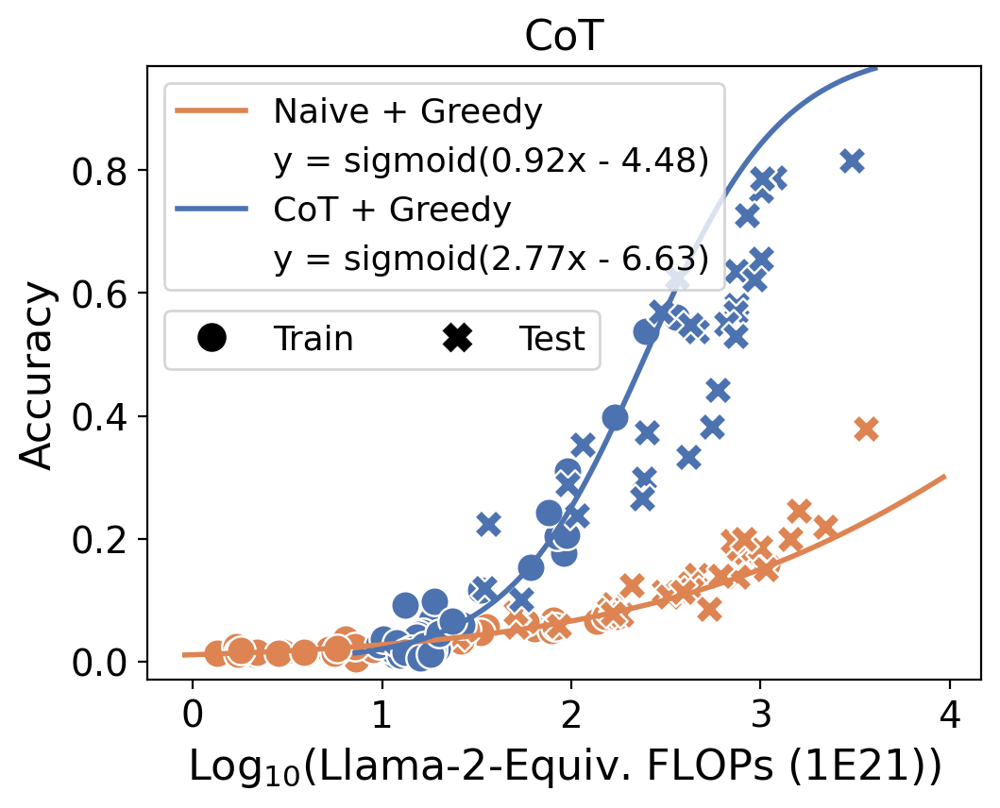

In [4]:
fig, all_fit_results, _ = plot_scaling_comparison_multi_metrics(
    eval_df=base_llm_eval_with_post_training, 
    y_metric_list=GSM8K_COT_SCALING_METRICS, 
    x_metrics_list=[ALL_BENCHMARK_METRIC_LIST], 
    analysis_setup_kwargs=SCALING_SETUP_KWARGS, 
    y_metric_specific_kwargs=GSM8K_SETUP_SPECIFIC_KWARGS,
    ymetric2title_map=GSM8K_METHOD_SCALING_ORIG_METRIC_MAP, 
    ymetric2color_map=GSM8K_METHOD_SCALING_COLOR_MAP,
    plot_title="CoT"
)

### Naive

[Text(0.5, 0, 'MMLU'),
 Text(1.5, 0, 'ARC-C'),
 Text(2.5, 0, 'HellaSwag'),
 Text(3.5, 0, 'Winograd'),
 Text(4.5, 0, 'TruthfulQA'),
 Text(5.5, 0, 'XWinograd'),
 Text(6.5, 0, 'HumanEval')]

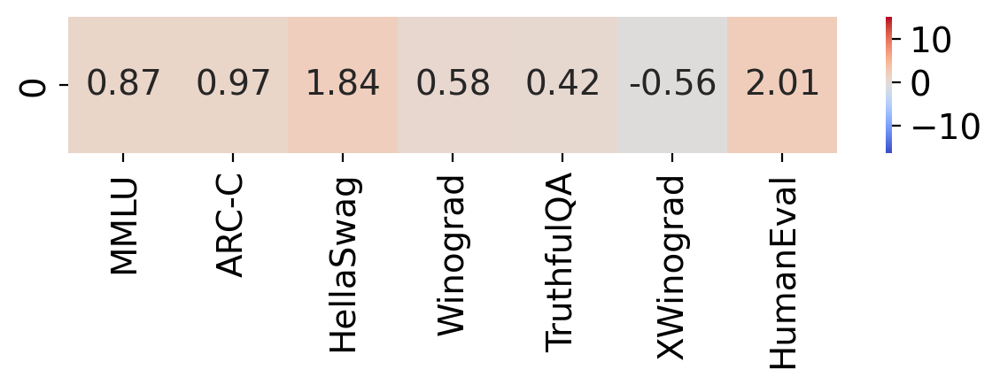

In [5]:
fig, ax = plt.subplots(figsize=(7,1))
sns.heatmap(all_fit_results[0]['popt'][1:].reshape(1,7), annot=True, fmt='.2f', cmap='coolwarm', vmin=15, vmax=-15, ax=ax)
#ax.set_yticklabels(imputed_metric_pc.columns)
ax.set_xticklabels(ALL_BENCHMARK_METRIC_LIST, rotation=90)

### CoT

[Text(0.5, 0, 'MMLU'),
 Text(1.5, 0, 'ARC-C'),
 Text(2.5, 0, 'HellaSwag'),
 Text(3.5, 0, 'Winograd'),
 Text(4.5, 0, 'TruthfulQA'),
 Text(5.5, 0, 'XWinograd'),
 Text(6.5, 0, 'HumanEval')]

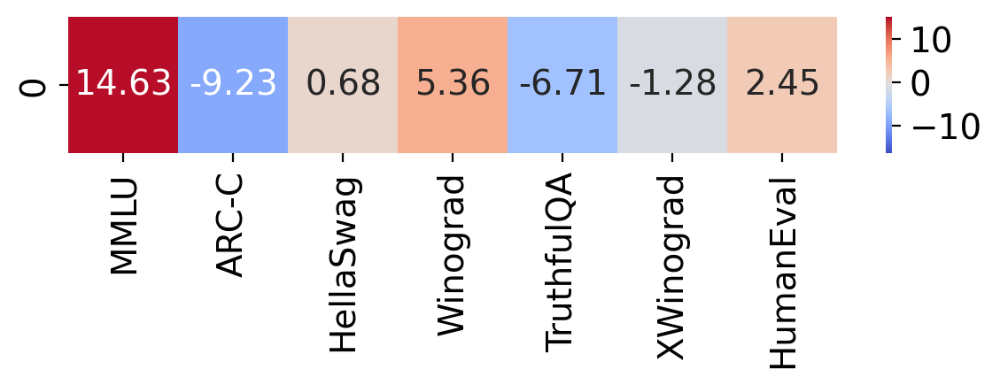

In [6]:
fig, ax = plt.subplots(figsize=(7,1))
sns.heatmap(all_fit_results[1]['popt'][1:].reshape(1,7), annot=True, fmt='.2f', cmap='coolwarm', vmin=15, vmax=-15, ax=ax)
#ax.set_yticklabels(imputed_metric_pc.columns)
ax.set_xticklabels(ALL_BENCHMARK_METRIC_LIST, rotation=90)

### Difference

In [7]:
def plot_bbh_scaling_curves_raw_benchmarks_scores(base_llm_eval_with_post_training,
                                                  task: str = "overall",
                                                  mmlu_subtasks: list = [],
                                                  lambda_: float = 0.1,
                                                  loss: str = "robust"):
    """ Plot the scaling curves for BBH subtasks using raw benchmark scores instead of PCA.
    """

    TASK = task

    NONGSM_METRIC_LIST = ['ARC-C', 'HellaSwag', 'Winograd', 'TruthfulQA', 'XWinograd', 'HumanEval', 'GSM8K'] + mmlu_subtasks

    BBH_PCA_PREPROCESS_KWARGS = DEFAULT_PCA_PREPROCESS_KWARGS.copy()
    BBH_PCA_PREPROCESS_KWARGS["imputation_metrics"] = NONGSM_METRIC_LIST
    BBH_PCA_PREPROCESS_KWARGS["pca_metrics"] = NONGSM_METRIC_LIST

    SCALING_SETUP_KWARGS = {
        # Data preprocessing: PCA imputation and extraction
        **BBH_PCA_PREPROCESS_KWARGS, 
        
        # Non-lineariy: sigmoid with parametrized scale and shift
        "nonlinearity": "sigmoid",

        # Cutoff: 8.4E22 FLOPs corresponding to LLama-2 7B
        #"split_method": "cutoff_by_FLOPs (1E21)",
        #"cutoff_threshold": 84,

        # Model families: include all we have evaled
        "df_filter": lambda x: x['Model Family'].isin(EVAL_BASE_MODEL_FAMILIES),   
        "df_groupby": 'Model Family',  # group markers by model family

        # Regression: ordinary least squares
        "reg_method": loss,  # default is 'robust'
        "reg_kwargs": {"delta": 1.0, # huber loss with delta=1.0 for normalized target within [0, 1] reduces to OLS
                       "lambda": lambda_},  
    }

    ################ /!\ NO PCA /!\ ################
    SCALING_SETUP_KWARGS['apply_pca'] = False

    if 'GSM8K' in NONGSM_METRIC_LIST:
        NONGSM_METRIC_LIST.remove('GSM8K')

    PLOT_X_METRICS_LIST = [MODEL_SIZE_METRIC, TRAINING_FLOPS_METRIC, NONGSM_METRIC_LIST] 
    #################################################

    color_palette = sns.color_palette()
    PLOT_BBH_METHOD_SCALING_ORIG_METRIC_MAP = {
        f"bbh_fewshot_{TASK}_3_exact_match,flexible-extract,norm": "Naive - Greedy",
        f"bbh_cot_fewshot_{TASK}_3_exact_match,flexible-extract,norm": "CoT - Greedy",
        'difference': 'CoT - Naive'
    }
    PLOT_BBH_METHOD_SCALING_COLOR_MAP = {
        f'bbh_fewshot_{TASK}_3_exact_match,flexible-extract,norm': color_palette[1],
        f'bbh_cot_fewshot_{TASK}_3_exact_match,flexible-extract,norm': color_palette[0],
        'difference': color_palette[3],
    }
    
    PLOT_BBH_METHOD_SCALING_METRICS = list(PLOT_BBH_METHOD_SCALING_ORIG_METRIC_MAP.keys())

    PLOT_BBH_SETUP_SPECIFIC_KWARGS = {}
    for e in PLOT_BBH_METHOD_SCALING_METRICS:
        PLOT_BBH_SETUP_SPECIFIC_KWARGS[e] = {
            "plot_adjust_kwargs": {"title": PLOT_BBH_METHOD_SCALING_ORIG_METRIC_MAP[e], "ylabel": "Accuracy"},
        }


    PLOT_BBH_METHOD_SCALING_METRICS.reverse()
    metric_for_difference = PLOT_BBH_METHOD_SCALING_METRICS[1:]
    
    fig, all_fit_results, metric = plot_scaling_comparison_multi_metrics(
        base_llm_eval_with_post_training, 
        y_metric_list=['difference'], 
        metrics_for_difference=metric_for_difference,
        x_metrics_list=[NONGSM_METRIC_LIST], 
        analysis_setup_kwargs=SCALING_SETUP_KWARGS, 
        y_metric_specific_kwargs=PLOT_BBH_SETUP_SPECIFIC_KWARGS,
        ymetric2title_map=PLOT_BBH_METHOD_SCALING_ORIG_METRIC_MAP, 
        ymetric2color_map=PLOT_BBH_METHOD_SCALING_COLOR_MAP,
        plot_title="Difference Naive Prompting and CoT"
    )

    return all_fit_results, metric


def plot_raw_benchmarks_weights(fit_results: dict, 
                                vmax=15,
                                mmlu_subtasks: list = [],
                                norm_weights: bool = False
):
    NONGSM_METRIC_LIST = ['ARC-C', 'HellaSwag', 'Winograd', 'TruthfulQA', 'XWinograd', 'HumanEval'] + mmlu_subtasks
    weights = fit_results['popt'][1:].reshape(1,len(NONGSM_METRIC_LIST))
    if norm_weights:
        weights = weights / np.linalg.norm(weights, axis=1, keepdims=True)

    if 'GSM8K' in NONGSM_METRIC_LIST:
        NONGSM_METRIC_LIST.remove('GSM8K')
    
    fig, ax = plt.subplots(figsize=(18,1))
    sns.heatmap(weights, annot=True, fmt='.2f', 
                cmap='coolwarm', vmin=-vmax, vmax=vmax, ax=ax, annot_kws={"fontsize":8})
        
    ax.set_xticklabels(NONGSM_METRIC_LIST, rotation=90)
    return weights

Difference: bbh_cot_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm - bbh_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm
Reference model family: 2 models
Difference: bbh_cot_fewshot_causal_judgement_3_exact_match,flexible-extract,norm - bbh_fewshot_causal_judgement_3_exact_match,flexible-extract,norm
Reference model family: 2 models
Difference: bbh_cot_fewshot_date_understanding_3_exact_match,flexible-extract,norm - bbh_fewshot_date_understanding_3_exact_match,flexible-extract,norm
Reference model family: 2 models
Difference: bbh_cot_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm - bbh_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm
Reference model family: 2 models
Difference: bbh_cot_fewshot_dyck_languages_3_exact_match,flexible-extract,norm - bbh_fewshot_dyck_languages_3_exact_match,flexible-extract,norm
Reference model family: 2 models
Difference: bbh_cot_fewshot_formal_fallacies_3_exact_match,flexible-extract,norm - bbh_

KeyboardInterrupt: 

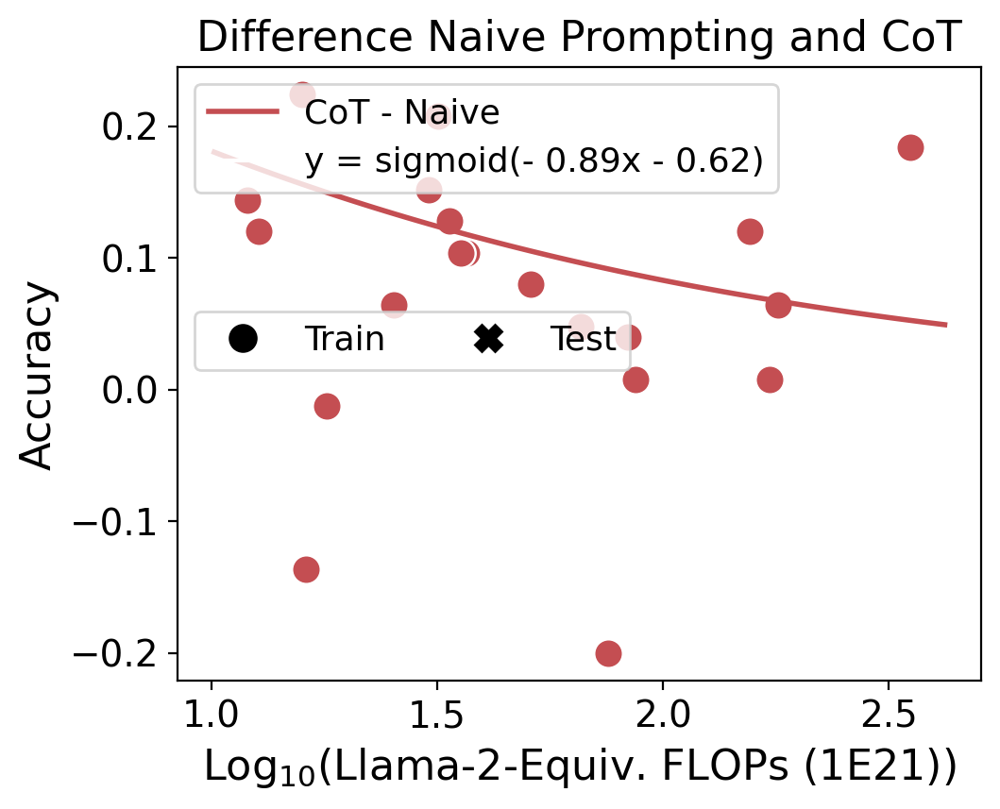

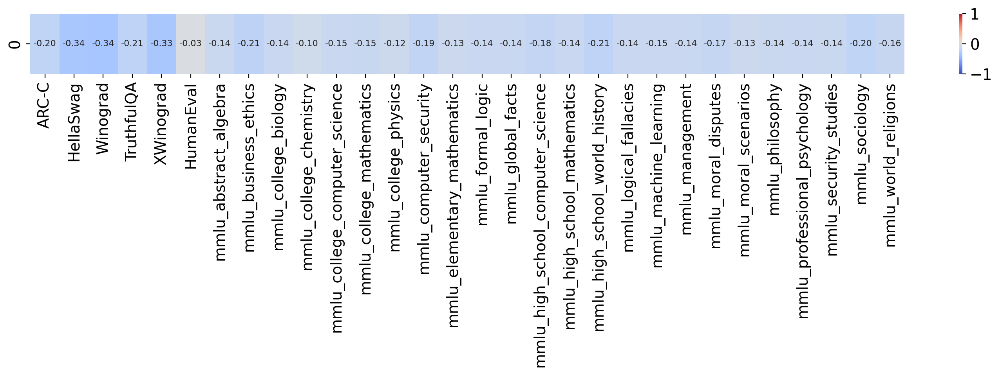

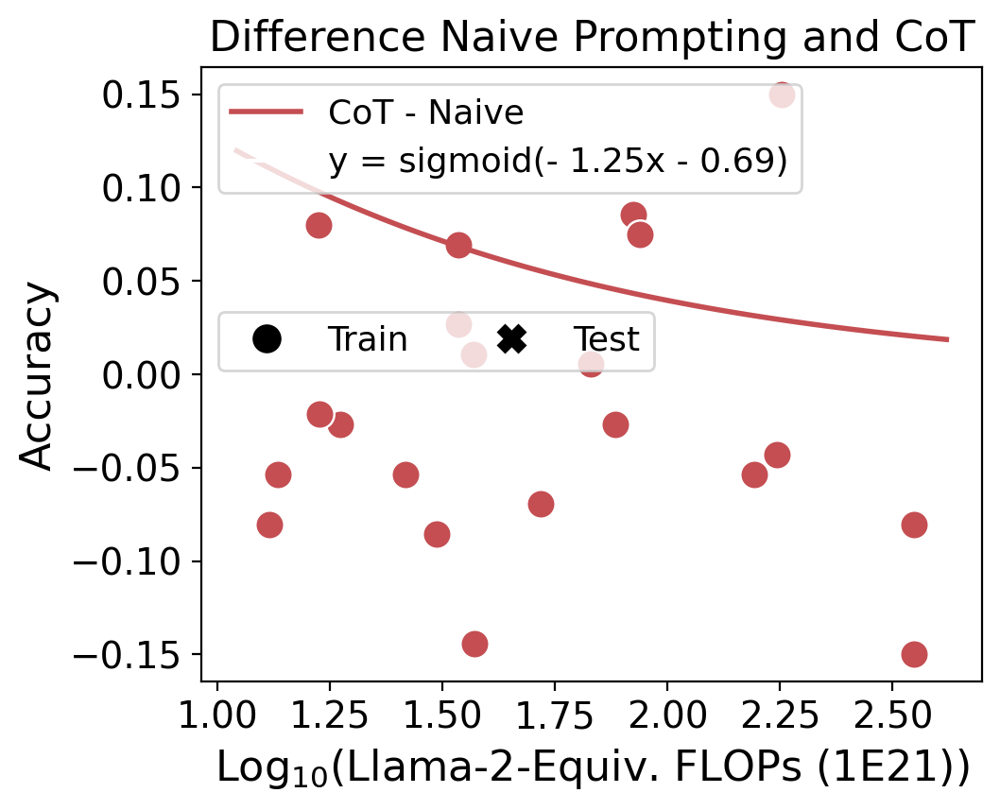

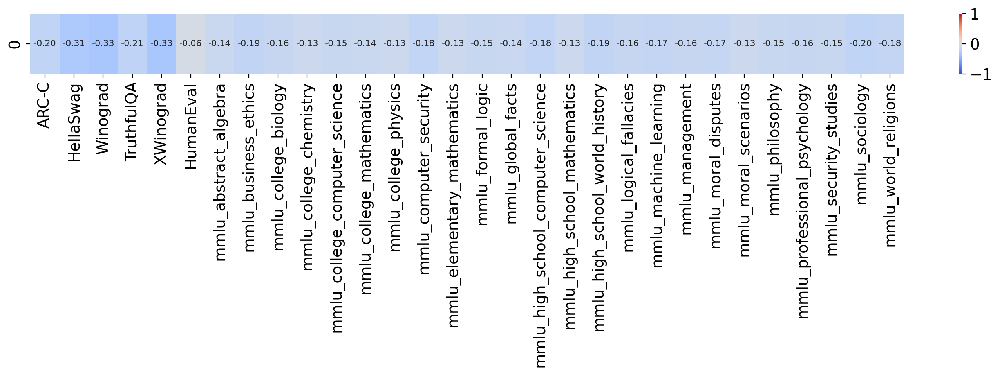

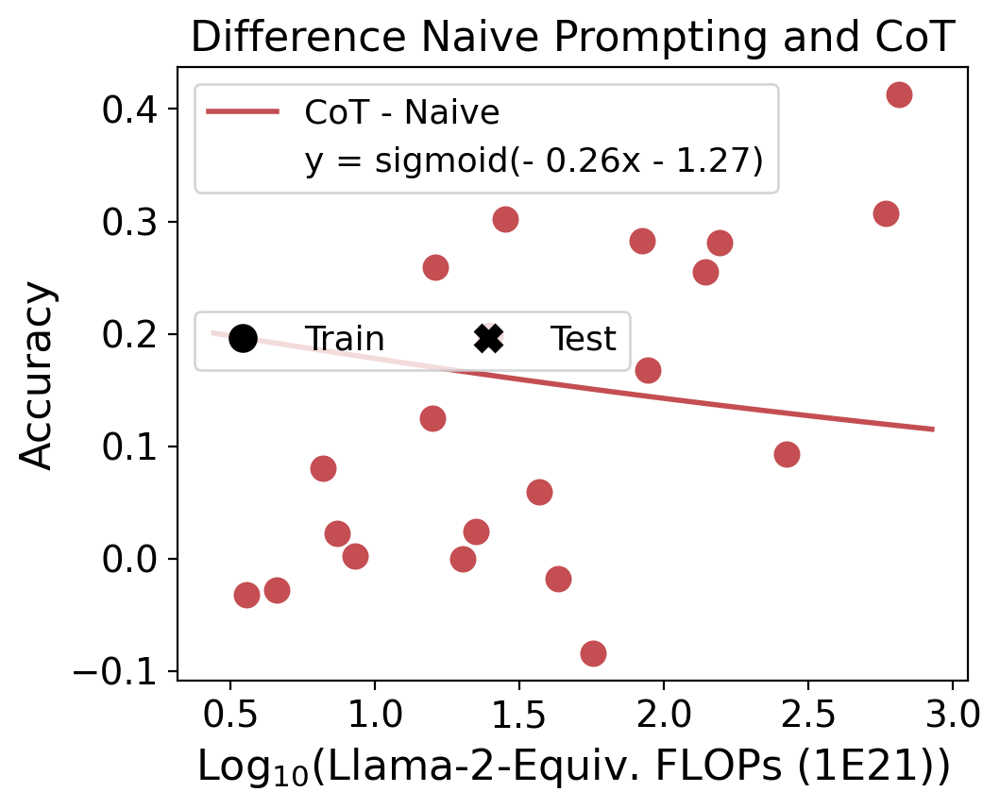

...

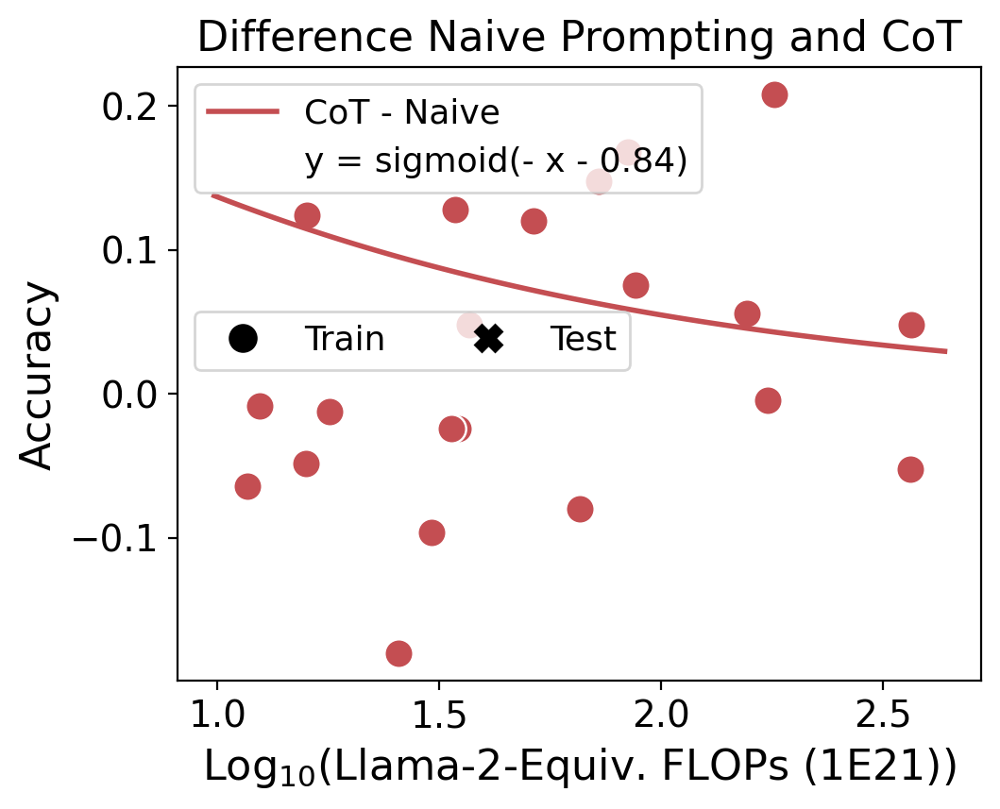

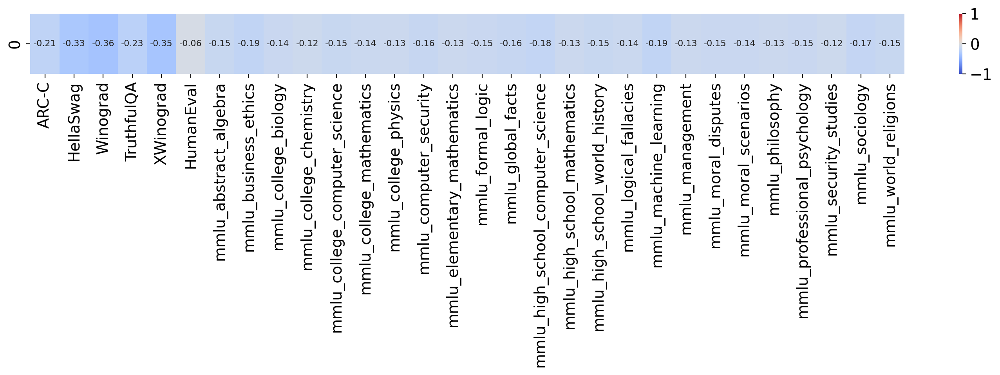

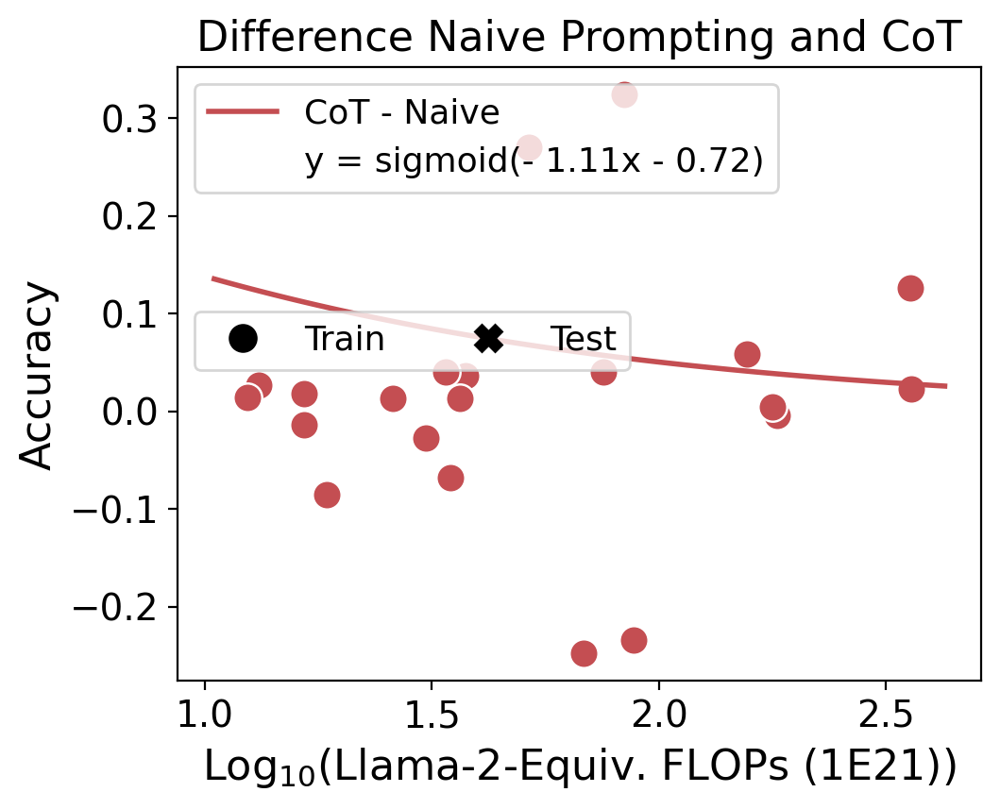

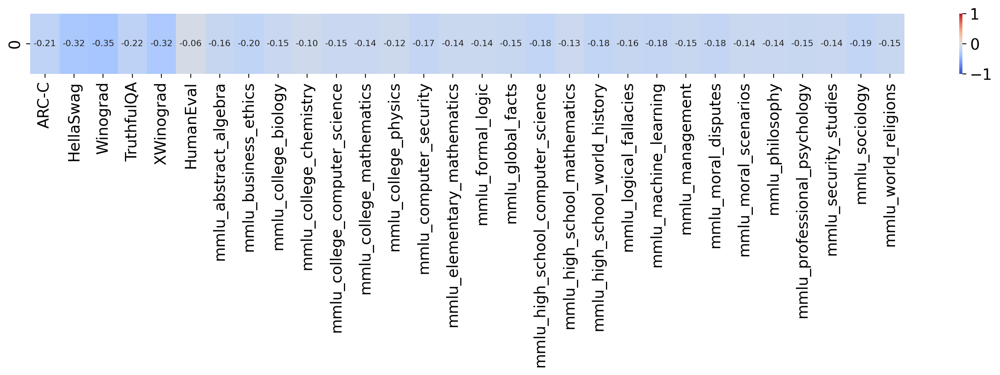

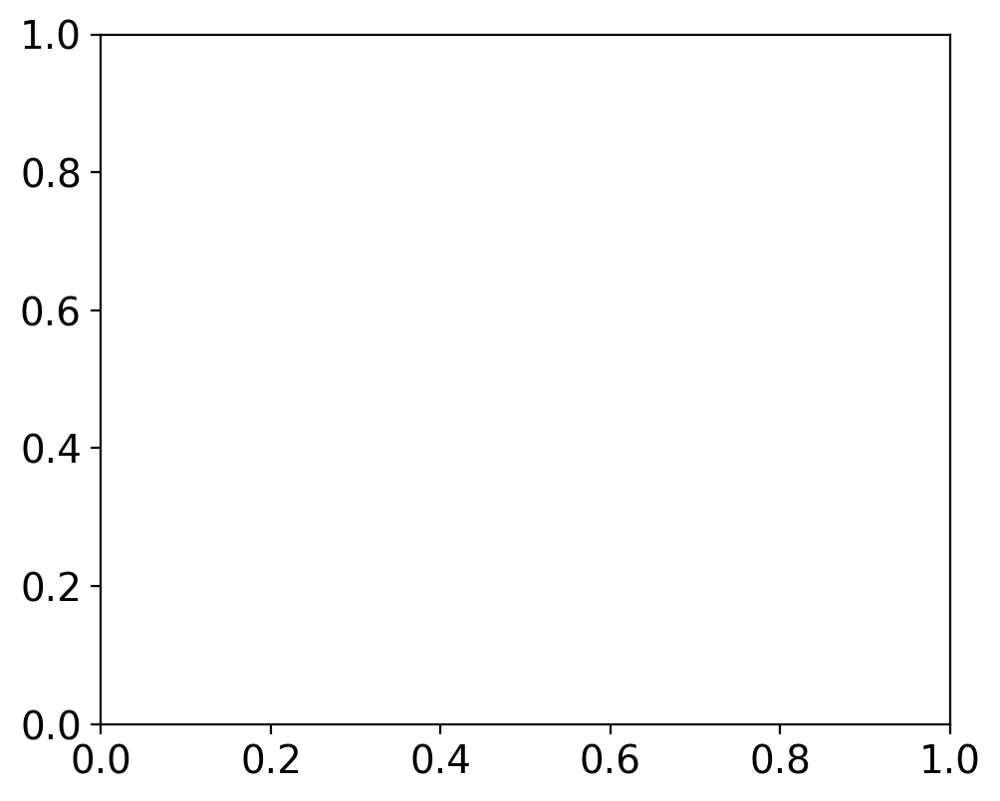

In [8]:
base_llm_benchmark_eval = load_base_llm_benchmark_eval()
eval_result_path = "./eval_results/base_llm_post_training_eval.csv"
post_training_eval = pd.read_csv(eval_result_path)

# Merge 
base_llm_eval_with_post_training = pd.merge(base_llm_benchmark_eval, post_training_eval, on="Model")

mmlu_df = load_acc_mmlu_subtasks()
merged_eval = merge_mmlu_sutasks_with_init_df(base_llm_eval_with_post_training, mmlu_df)

mmlu_subtasks = [t for t in mmlu_df.columns if t != 'Model' and t != 'model_name']


metrics = pd.DataFrame()

for lambda_ in [0.1]:

    current_lambda_mse = []
    current_lambda_mae = []
    for bench in BBH_SUBTASKS:
        fit_results, metric = plot_bbh_scaling_curves_raw_benchmarks_scores(merged_eval,
                                                                            task=bench,
                                                                            mmlu_subtasks=mmlu_subtasks,
                                                                            loss='ridge',
                                                                            lambda_=lambda_)

        weights = plot_raw_benchmarks_weights(fit_results[0], vmax=1, mmlu_subtasks=mmlu_subtasks, norm_weights=True)
        #fig.savefig(f"/scratch2/jsalle/ObsScaling/notebooks/figures/weights_difference/norm_weights_lasso_bbh_{bench}.png")
        
        current_lambda_mae.append(metric['mae_train'])
        current_lambda_mse.append(metric['mse_train'])

    metrics = pd.concat([metrics, pd.DataFrame({"lambda": lambda_,
                                                "mae": np.mean(current_lambda_mae),
                                                "mse": np.mean(current_lambda_mse)}, index=[0])], ignore_index=True)
                                                                                               
metrics.plot(y=['mae', 'mse'], x='lambda')

In [ ]:
metrics

,lambda,mae,mse
0,0.01,0.103056,0.017755


### Ranking

In [ ]:
weights_ranks = pd.DataFrame()

if 'GSM8K' in NONGSM_METRIC_LIST:
    NONGSM_METRIC_LIST.remove('GSM8K')
if 'MMLU' in NONGSM_METRIC_LIST:
    NONGSM_METRIC_LIST.remove('MMLU')
all_subtasks = NONGSM_METRIC_LIST + mmlu_subtasks

for task in BBH_SUBTASKS:

    fit_results, metric = plot_bbh_scaling_curves_raw_benchmarks_scores(merged_eval,
                                                                        task=task,
                                                                        mmlu_subtasks=mmlu_subtasks,
                                                                        loss='lasso',
                                                                        lambda_=0.01)

    weights = plot_raw_benchmarks_weights(fit_results[0], vmax=1, mmlu_subtasks=mmlu_subtasks, norm_weights=True)
    weights = weights.tolist()

    weights_ranks_list = [sorted(weights[0], reverse=True).index(x) for x in weights[0]]

    for i, bench in enumerate(all_subtasks):

        temp_dict = {
            'task': task,
            'benchmark': bench,
            'rank': weights_ranks_list[i]
        }
        temp_df = pd.DataFrame(temp_dict, index=[0])
        
        weights_ranks = pd.concat([weights_ranks, temp_df], axis=0, ignore_index=True)
    

Difference: bbh_cot_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm - bbh_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_causal_judgement_3_exact_match,flexible-extract,norm - bbh_fewshot_causal_judgement_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_date_understanding_3_exact_match,flexible-extract,norm - bbh_fewshot_date_understanding_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm - bbh_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm


Text(0.5, 1.0, 'Mean rank on all BBH subtasks Ridge (lambda=1)')

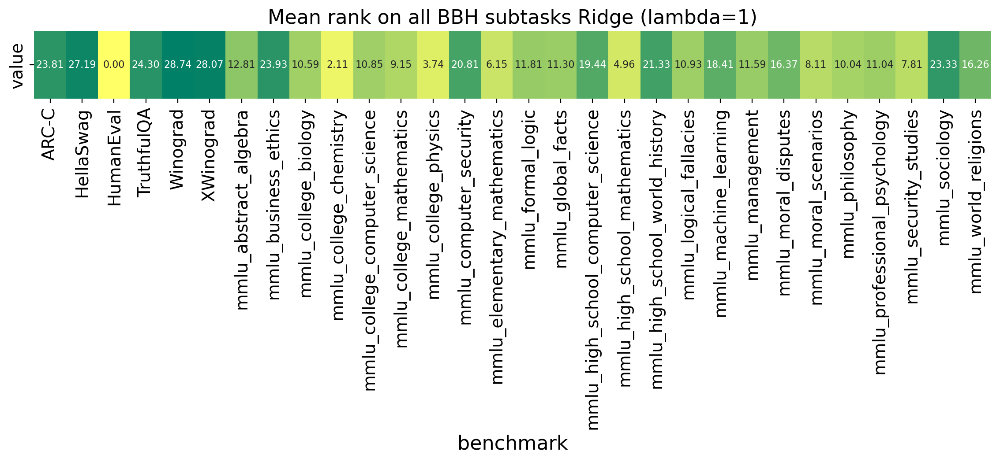

In [ ]:
mean_ranks = weights_ranks.groupby(['benchmark'])['rank'].mean()

plt.figure(figsize=(14, 1))
sns.heatmap(mean_ranks.to_frame(name='value').T, cmap='summer_r', annot=True, fmt=".2f", cbar=False, annot_kws={"fontsize": 8})
plt.title('Mean rank on all BBH subtasks Lasso (lambda=0.01)')

## PCA components

Missing values in training data: 20.00%


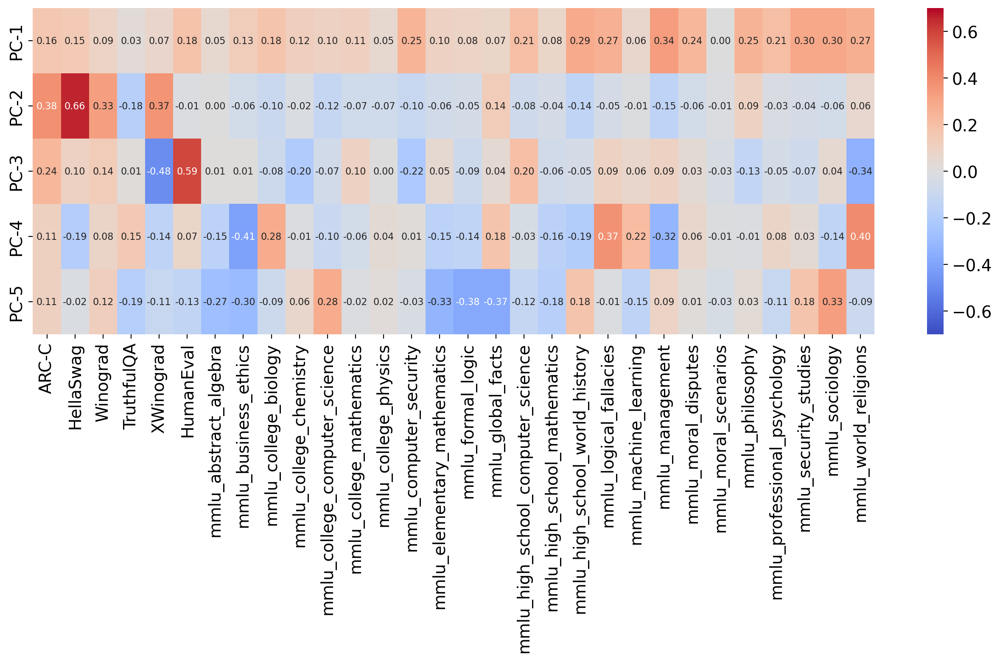

In [ ]:
pca_impute_metrics = ['ARC-C', 'HellaSwag', 'Winograd', 'TruthfulQA', 'XWinograd', 'HumanEval'] + mmlu_subtasks
metric_df = merged_eval[pca_impute_metrics]

impute_kwargs = DEFAULT_PCA_PREPROCESS_KWARGS['imputation_kwargs'].copy()
impute_kwargs['verbose'] = True
imputed_metric_df, _ = pca_impute(metric_df, **impute_kwargs)

pca, imputed_metric_pc, _ = perform_pca(imputed_metric_df, **DEFAULT_PCA_PREPROCESS_KWARGS['pca_kwargs']) 

fig, ax = plt.subplots(figsize=(16, 5))

# nicer visualization: make the PC dims mostly "postively" correlated to model performance
vis_weights = pca.components_.copy()
for idx in [1, 3, 4]:
    vis_weights[idx] *= -1

sns.heatmap(vis_weights, annot=True, fmt='.2f', cmap='coolwarm', ax=ax, vmin=-0.7, vmax=0.7, annot_kws={"fontsize":8})
ax.set_yticklabels(imputed_metric_pc.columns)
ax.set_xticklabels(pca_impute_metrics, rotation=90)

plt.show()

/tmp/ipykernel_193236/157253771.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(range(1, n_components+1))


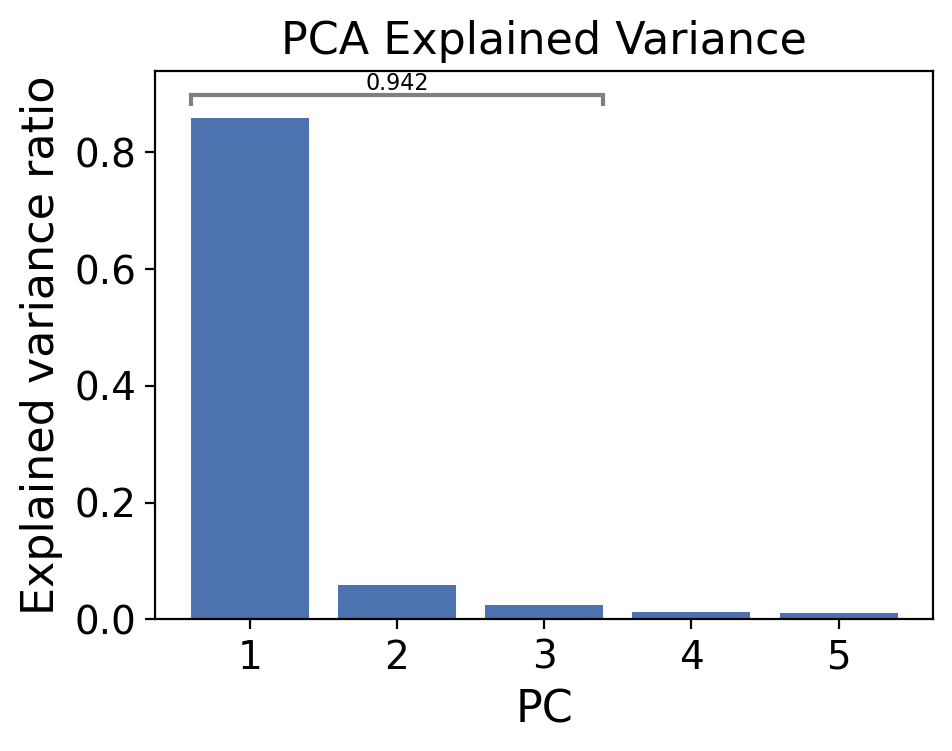

In [ ]:
import matplotlib.patches as patches
from matplotlib.path import Path

n_components = DEFAULT_PCA_PREPROCESS_KWARGS['pca_kwargs']['n_components']
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.bar(range(1, n_components + 1), pca.explained_variance_ratio_)

ax.set_xticklabels(range(1, n_components+1))
ax.set_xticks(range(1, n_components+1))
ax.set_xlabel("PC")
ax.set_ylabel("Explained variance ratio")

top_n = 3

sum_top_n = pca.explained_variance_ratio_[:top_n].sum() 

# Draw a custom curly brace (half bracket) above the top 3 bars
brace_height = max(pca.explained_variance_ratio_[:top_n]) + 0.02  # Slightly higher to clear the bars
brace_x_start = 1 - 0.4  # Slightly before the first bar
brace_x_end = 3 + 0.4   # Slightly past the third bar

# Define the points for the path (a simple upside-down half-bracket)
vertices = [
    (brace_x_start, brace_height),  # Left bottom of the brace
    (brace_x_start, brace_height + 0.02),  # Left top of the brace
    (brace_x_end, brace_height + 0.02),  # Right top of the brace
    (brace_x_end, brace_height),  # Right bottom of the brace
]
codes = [Path.MOVETO, Path.LINETO, Path.LINETO, Path.LINETO]

path = Path(vertices, codes)
patch = patches.PathPatch(path, facecolor='none', lw=1.5, edgecolor='gray')
ax.add_patch(patch)

# Annotation for the brace
ax.annotate(f"{sum_top_n:.3f}", 
            ((brace_x_start + brace_x_end) / 2, brace_height + 0.02),  # Position for the text
            textcoords="data",
            ha="center", va="bottom", fontsize=8)
ax.set_title("PCA Explained Variance")

ax.set_ylim([0.0, 0.94])

plt.tight_layout()

plt.show()

## PCA projection

Difference: bbh_cot_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm - bbh_fewshot_boolean_expressions_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_causal_judgement_3_exact_match,flexible-extract,norm - bbh_fewshot_causal_judgement_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_date_understanding_3_exact_match,flexible-extract,norm - bbh_fewshot_date_understanding_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm - bbh_fewshot_disambiguation_qa_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_dyck_languages_3_exact_match,flexible-extract,norm - bbh_fewshot_dyck_languages_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_formal_fallacies_3_exact_match,flexible-extract,norm - bbh_fewshot_formal_fallacies_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_geometric_shapes_3_exact_match,flexible-extract,norm - bbh_fewshot_geometric

/scratch2/jsalle/ObsScaling/utils/plot.py:837: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



Difference: bbh_cot_fewshot_logical_deduction_three_objects_3_exact_match,flexible-extract,norm - bbh_fewshot_logical_deduction_three_objects_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_movie_recommendation_3_exact_match,flexible-extract,norm - bbh_fewshot_movie_recommendation_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_multistep_arithmetic_two_3_exact_match,flexible-extract,norm - bbh_fewshot_multistep_arithmetic_two_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_navigate_3_exact_match,flexible-extract,norm - bbh_fewshot_navigate_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_object_counting_3_exact_match,flexible-extract,norm - bbh_fewshot_object_counting_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_penguins_in_a_table_3_exact_match,flexible-extract,norm - bbh_fewshot_penguins_in_a_table_3_exact_match,flexible-extract,norm
Difference: bbh_cot_fewshot_reasoning_about_colored_objects_3_exact_ma

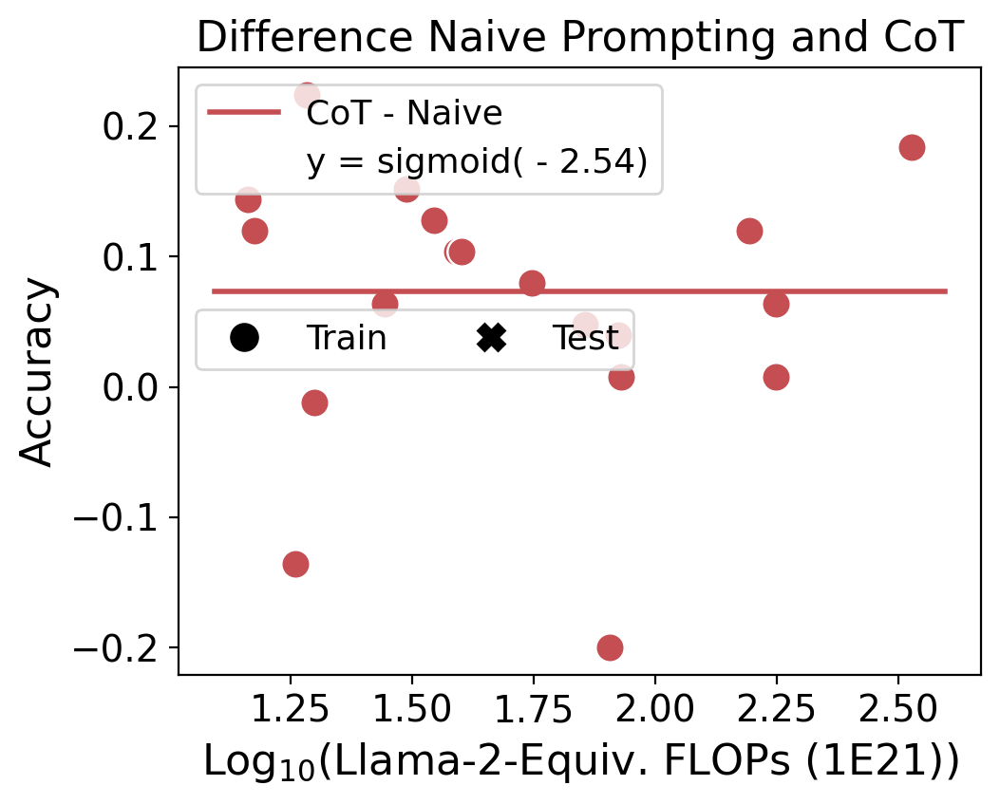

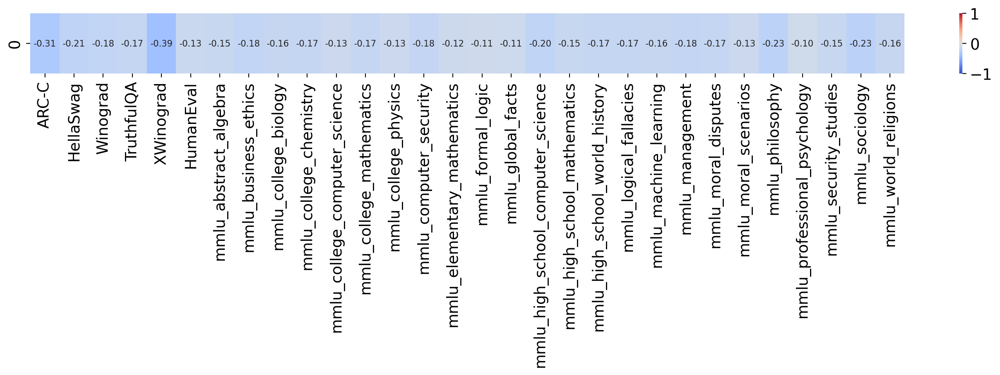

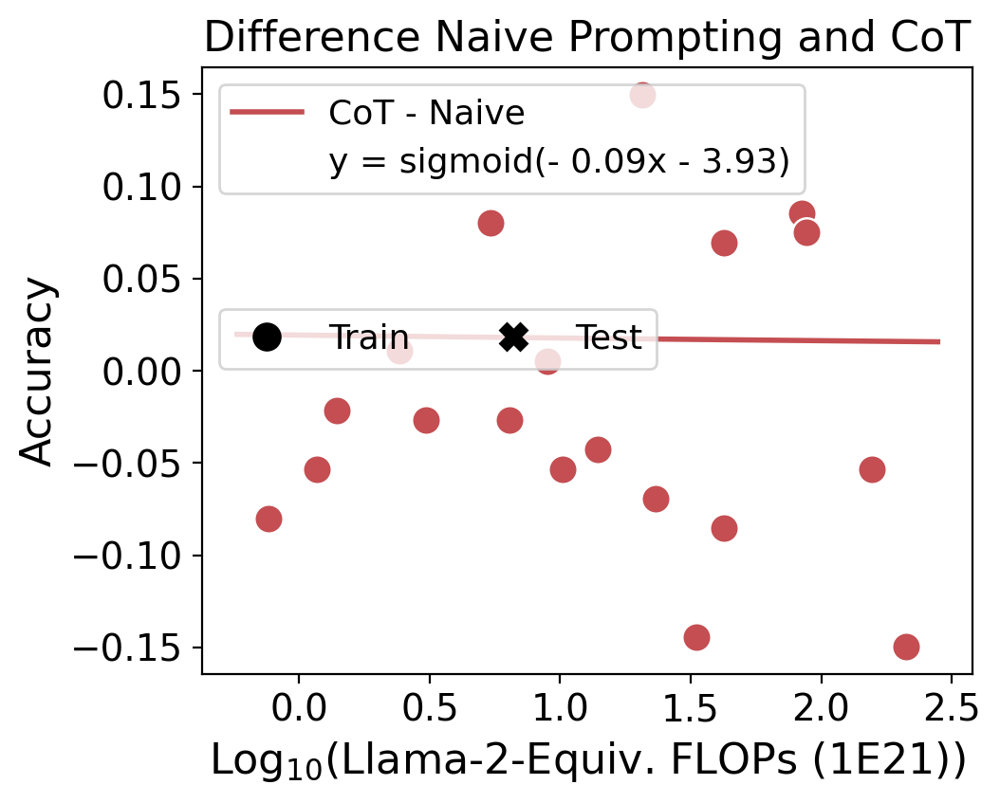

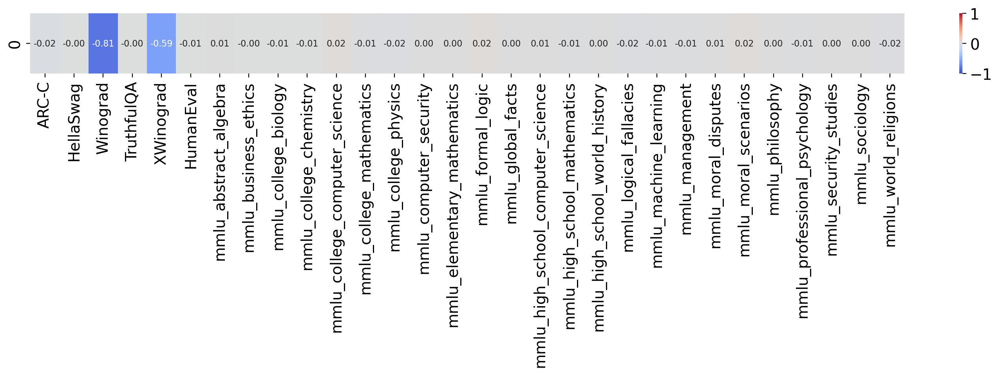

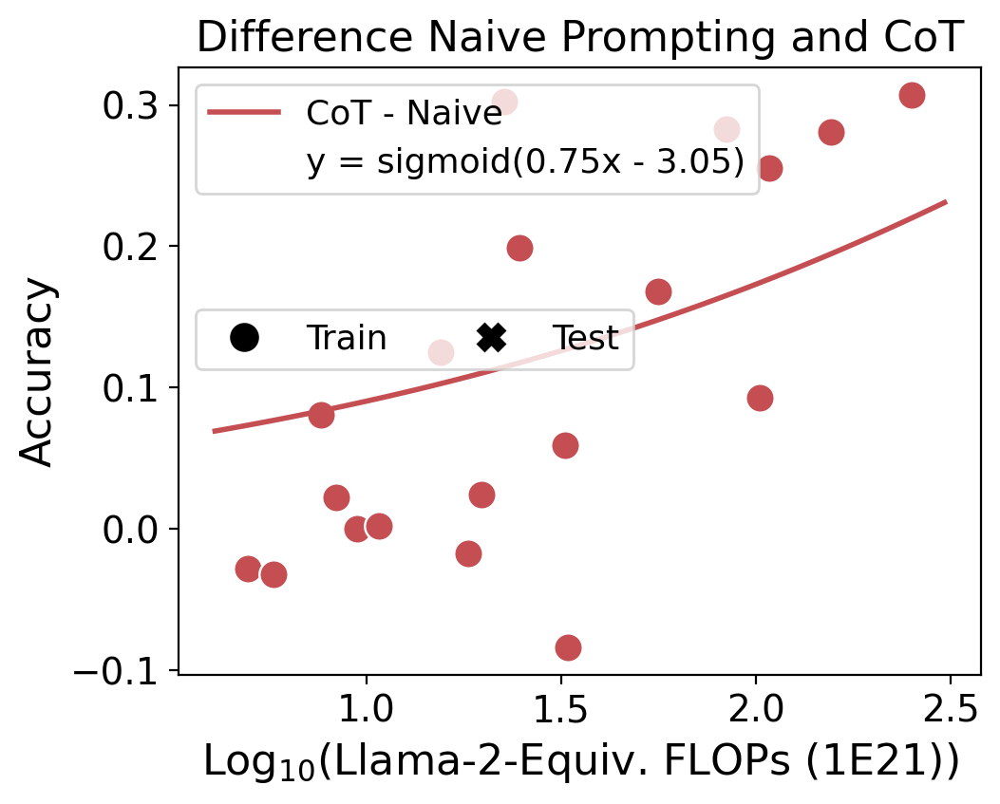

...

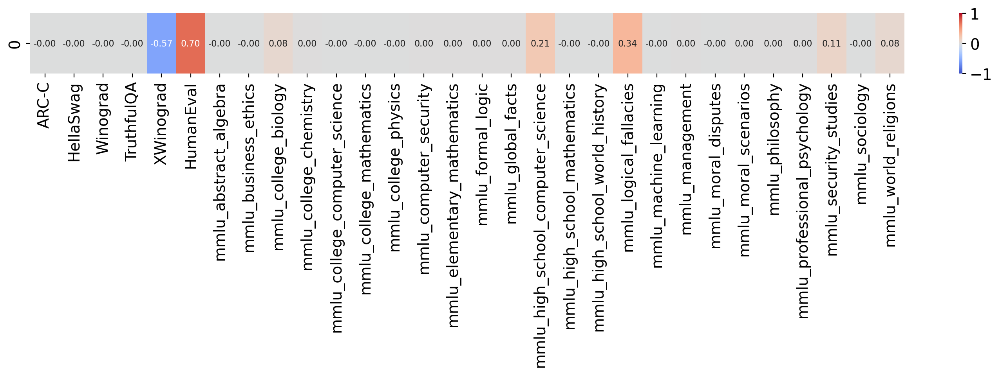

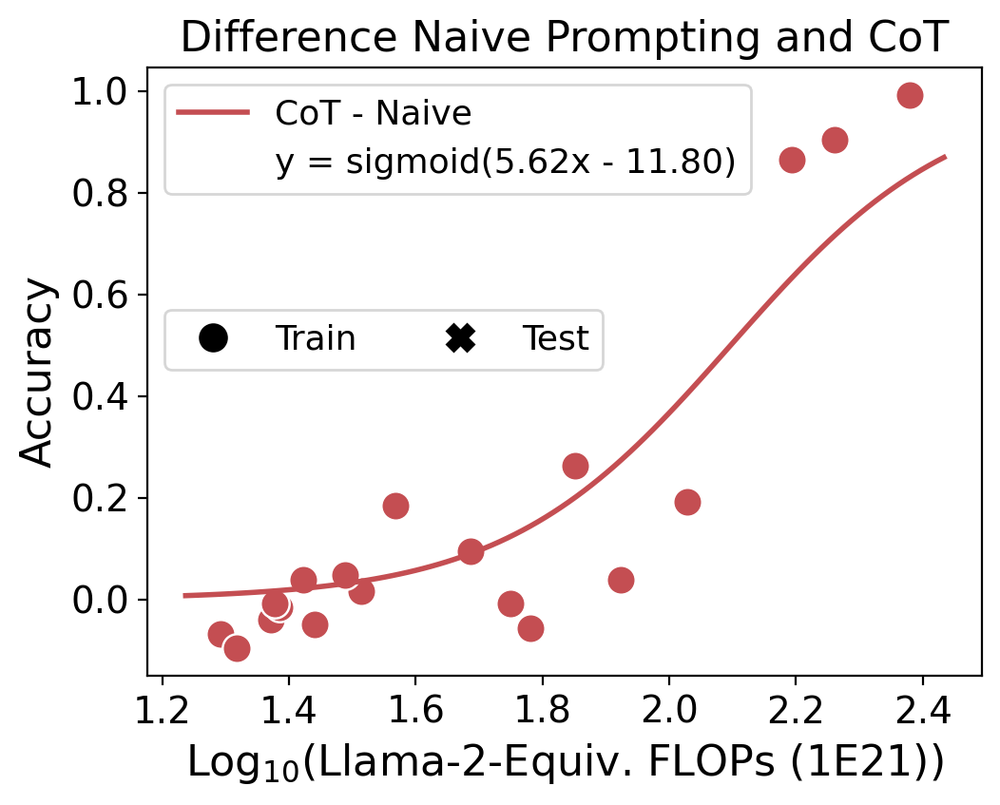

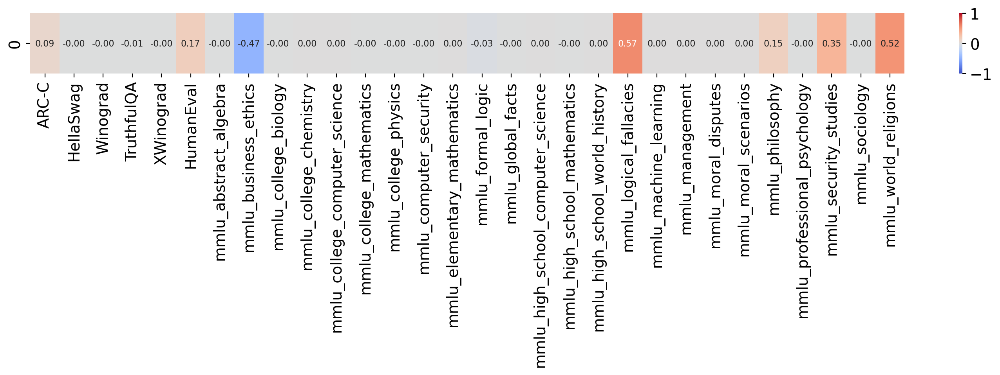

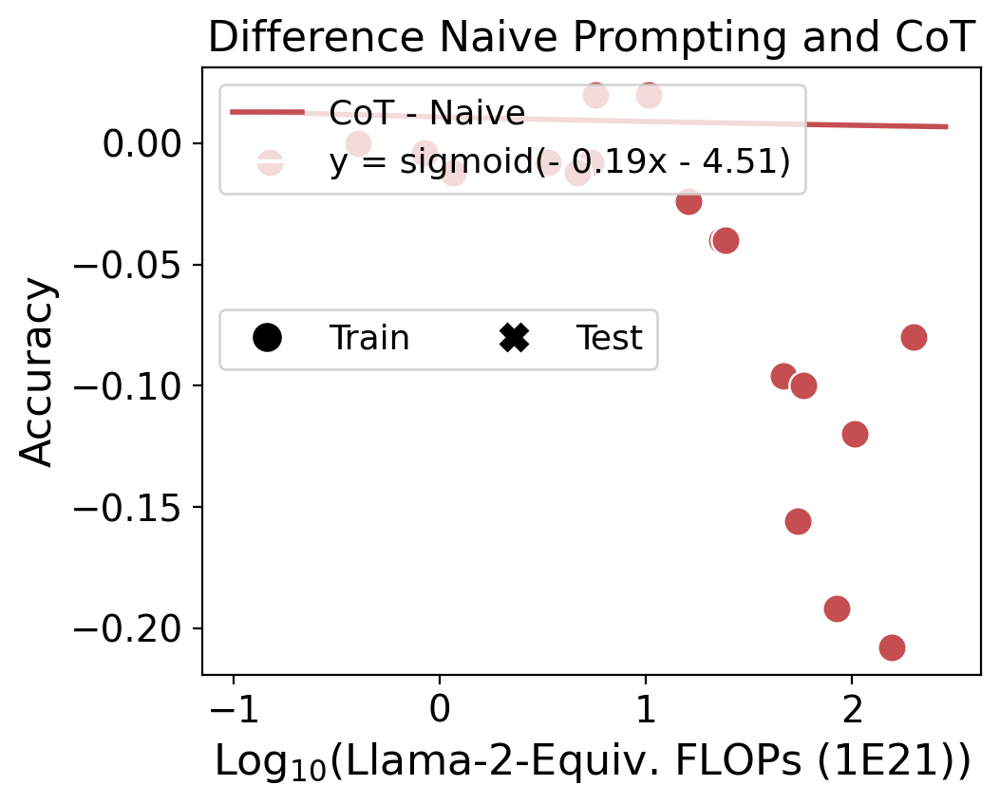

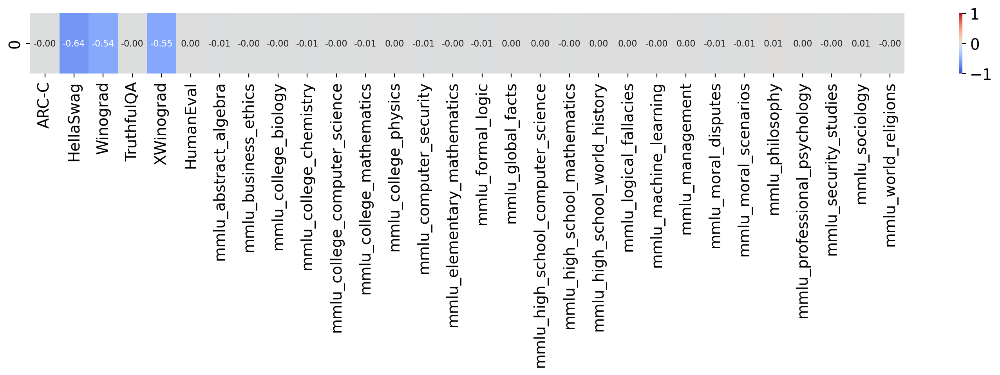

In [ ]:
base_llm_benchmark_eval = load_base_llm_benchmark_eval()
eval_result_path = "./eval_results/base_llm_post_training_eval.csv"
post_training_eval = pd.read_csv(eval_result_path)

# Merge 
base_llm_eval_with_post_training = pd.merge(base_llm_benchmark_eval, post_training_eval, on="Model")

mmlu_df = load_acc_mmlu_subtasks()
merged_eval = merge_mmlu_sutasks_with_init_df(base_llm_eval_with_post_training, mmlu_df)

mmlu_subtasks = [t for t in mmlu_df.columns if t != 'Model' and t != 'model_name']

NONGSM_METRIC_LIST = ['ARC-C', 'HellaSwag', 'Winograd', 'TruthfulQA', 'XWinograd', 'HumanEval'] + mmlu_subtasks
weights_all_subtasks = np.zeros((len(BBH_SUBTASKS), len(NONGSM_METRIC_LIST)))

for i, bench in enumerate(BBH_SUBTASKS):
    fit_results, metric = plot_bbh_scaling_curves_raw_benchmarks_scores(merged_eval,
                                                                        task=bench,
                                                                        mmlu_subtasks=mmlu_subtasks,
                                                                        loss='lasso',
                                                                        lambda_=0.01)

    fig = plot_raw_benchmarks_weights(fit_results[0],
                                    vmax=1,
                                    mmlu_subtasks=mmlu_subtasks,
                                    norm_weights=True)

    weights = fit_results[0]['popt'][1:].reshape(1,len(NONGSM_METRIC_LIST))
    weights_all_subtasks[i, :] = weights

In [ ]:
import plotly.graph_objects as go

projected_data = np.dot(weights_all_subtasks, pca.components_.T)

fig = go.Figure(data=go.Scatter(
    x=projected_data[:, 0],
    y=projected_data[:, 1],
    mode='markers',
    text=BBH_SUBTASKS,  # Use the annotations for hover text
    hoverinfo='text'  # Specifies that the hover information should display the text
))

annotations = [
    dict(
        x=projected_data[i, 0],
        y=projected_data[i, 1],
        text=BBH_SUBTASKS[i],
        showarrow=False,
        font=dict(size=10),
        xanchor='left',
        yanchor='bottom'
    ) for i in range(len(BBH_SUBTASKS))
]

# Update the layout of the plot
fig.update_layout(
    title='Projection onto Principal Components',
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    showlegend=False,
    template="plotly_white",
    annotations=annotations
)

Est-ce que l'importance du dataset ne reflète que sa difficulté ?

In [ ]:
import plotly.figure_factory as ff

def remove_nans_from_ndarray(array):
    array[array == 'NaN'] = np.nan
    float_array = array.astype(float)
    cleaned_array = float_array[~np.isnan(float_array)]
    return cleaned_array

hist_data = []
labels = []
for col in mmlu_df.columns:
    if col.startswith('mmlu_'):
        hist_data.append(remove_nans_from_ndarray(mmlu_df[col]))
        labels.append(col.split('mmlu_')[1])


fig = ff.create_distplot(hist_data, labels, bin_size=.2)
fig.show()